# Machine learning

Created by 
* [Li, Chaonan (李超男)](https://www.researchgate.net/profile/Chaonan-Li-5) / licn@mtc.edu.cn / [Ecological Security and Protection Key Laboratory of Sichuan Province, Mianyang Normal University](https://zdsys.mtc.edu.cn/)
* Liao, Haijun (廖海君) / liaohj@mtc.edu.cn /
[Engineering Research Center of Chuanxibei RHS Construction at Mianyang Normal University of Sichuan Province](https://rhs.mtc.edu.cn/)

Reviewed by [Li, Xiangzhen (李香真)](https://www.researchgate.net/profile/Xiangzhen-Li-2) / lixz@fafu.edu.cn /
[College of Resources and Environment, Fujian Agriculture and Forestry University](https://zhxy.fafu.edu.cn/main.htm)

To predict microbial traits in the unsampled areas, we also implemented several function for machine learning. See the follwoing examples for details.

## Load required R packages

Here we need four R packages for this section of microgeo R package tutorial. Just run the following codes to import them into R environment.

In [1]:
# Install and load `magrittr`, `ggplot2`, `devtools` and `microgeo` packages 
if (!suppressMessages(require(magrittr))) install.packages("magrittr")
if (!require(ggplot2)  %>% suppressMessages) install.packages("ggplot2")
if (!require(devtools) %>% suppressMessages) install.packages("devtools")
if (!require(microgeo) %>% suppressMessages) devtools::install_github("ChaonanLi/microgeo")

## Create a standard microgeo dataset

We also need a standard microgeo dataset for the presentations in the section of tutorial.

In [2]:
# Example by using the map downloaded from DataV.GeoAtlas
data(qtp)
map <- read_aliyun_map(adcode = c(540000, 630000, 510000)) %>% suppressMessages()
dataset.dts.aliyun <- create_dataset(mat = qtp$asv, ant = qtp$tax, met = qtp$met, map = map,
                                     phy = qtp$tre, env = qtp$env, lon = "longitude", lat = "latitude") 
dataset.dts.aliyun %<>% get_ai(out.dir = "../test/microgeo_data") 
dataset.dts.aliyun %<>% get_his_bioc(res = 2.5, out.dir = "../test/microgeo_data")
dataset.dts.aliyun %<>% get_fut_bioc(res = 2.5, out.dir = "../test/microgeo_data")
dataset.dts.aliyun %<>% get_modis_cla_metrics(username = "username", password = "password", 
                                              measures = "LC_Type1", out.dir = "../test/microgeo_data") 
dataset.dts.aliyun %<>% extract_data_from_spatraster()
dataset.dts.aliyun %<>% rarefy_count_table() 
dataset.dts.aliyun %<>% tidy_dataset()
dataset.dts.aliyun %<>% calc_rel_abund() 
dataset.dts.aliyun %>%  show_dataset()

ℹ [2023-10-12 10:51:10] INFO ==> all samples fall within the map area!

ℹ [2023-10-12 10:51:10] INFO ==> dataset has been created successfully!

ℹ [2023-10-12 10:51:10] INFO ==> use `object %>% show_dataset()` to check the summary of dataset.

✔ [2023-10-12 10:51:14] SAVE ==> new results have been saved to: object$spa$rast$his$AI

✔ [2023-10-12 10:51:27] SAVE ==> new results have been saved to: object$spa$rast$his(19 variables)

✔ [2023-10-12 10:52:02] SAVE ==> new results have been saved to: object$spa$rast$fut [19 variables; 4 groups]

ℹ [2023-10-12 10:52:02] INFO ==> preparing MODIS product list for searching...

ℹ [2023-10-12 10:52:02] INFO ==> searching avaliable MODIS products...

ℹ [2023-10-12 10:52:02] INFO ==> current product (1/1): MCD12Q1 (LC_Type1--> 2021-01-01 to 2021-12-31)

ℹ [2023-10-12 10:52:04] INFO ==> find 8 files with 0.09 GB in total...

ℹ [2023-10-12 10:52:04] INFO ==> downloading all avaliable MODIS products[skip if the file exists]...

ℹ [2023-10-12 10:52:04] I

── The Summary of Microgeo Dataset ─────────────────────────────────────────────


ℹ object$mat: 6807 ASVs/genes and 1089 samples [subsample depth: 5310]

ℹ object$ant: 6807 ASVs/genes and 7 annotation levels (Kingdom, Phylum, Class, Order, Family, Genus, Species)

ℹ object$met: 1089 samples and 2 variables (longitude, latitude)

ℹ object$map: a SpatialPolygonsDataFrame with the CRS of '+proj=longlat +datum=WGS84 +no_defs'

ℹ object$phy: a phylogenetic tree with 6807 tip labels

ℹ object$env: 1089 samples and 10 variables




── The Summary of Biogeographic Traits ─────────────────────────────────────────


✔ object$spa: 20 historically numeric variables; 1 historically classification variables; 4 groups of future climate data

✔ object$abd$raw: 7 abundance tables (Kingdom, Phylum, Class, Order, Family, Genus, Species)




• To check the summary of dataset, Replace `object` with the variable name of your dataset
• For example, if the variable name is `dataset.dts`you can run `head(dataset.dts$met)` to check the content of `met`


## Create a machine learning (ML) model

In [3]:
# Calculate ecological markers at family level
dataset.dts.aliyun %<>% calc_markers(use.dat = 'spa', use.var = 'AI', annotation.level = 'Family', r.thres = 0.3) %>% suppressMessages()

In [4]:
# Check the markers
head(dataset.dts.aliyun$abd$mar$correlation)

,var,r,p
,<fct>,<dbl>,<dbl>
f__SC.I.84,f__SC.I.84,0.5051362,1.395015e-71
f__A21b,f__A21b,0.4973923,3.969602e-69
f__Nitrosomonadaceae,f__Nitrosomonadaceae,0.4890011,1.541125e-66
f__Phaselicystidaceae,f__Phaselicystidaceae,0.4579174,1.495784e-57
f__Desulfarculaceae,f__Desulfarculaceae,0.4542917,1.458918e-56
f__Haliangiaceae,f__Haliangiaceae,0.4197123,1.047109e-47


In [5]:
# Create a regression random forest model for f__SC.I.84
rf.rst.reg <- create_ml_model(y.data = dataset.dts.aliyun$abd$mar$abundance, 
                              x.data = dataset.dts.aliyun$spa$tabs[,paste0("Bio", seq(19))], var = 'f__SC.I.84', method = 'rf')

In [6]:
# Create dataset for binary classification random forest model
family.bins <- data.frame(row.names = rownames(dataset.dts.aliyun$abd$mar$abundance), 
                          f__SC.I.84 = dataset.dts.aliyun$abd$mar$abundance$f__SC.I.84)
family.bins$f__SC.I.84 <- ifelse(family.bins$f__SC.I.84 > 0, "presence", "absence")
family.bins$f__SC.I.84 <- as.factor(family.bins$f__SC.I.84)

In [7]:
# Create a binary classification random forest model
rf.rst.cla.bin <- create_ml_model(y.data = family.bins, x.data = dataset.dts.aliyun$spa$tabs[,paste0("Bio", seq(19))],
                                  var = 'f__SC.I.84', method = 'rf', type = 'classification')

In [8]:
# Create dataset for mutiple class classification random forest model
family.mutiple <- data.frame(row.names = rownames(dataset.dts.aliyun$abd$mar$abundance), 
                             f__SC.I.84 = dataset.dts.aliyun$abd$mar$abundance$f__SC.I.84)
family.mutiple$f__SC.I.84 <- cut(family.mutiple$f__SC.I.84, breaks = c(-Inf, 0.05, 0.2, 0.9, Inf), labels = c("H", "A", "S", "Y"))
family.mutiple$f__SC.I.84 <- as.factor(family.mutiple$f__SC.I.84)

In [9]:
# Create a mutiple class classification random forest model
rf.rst.cla.mutiple <- create_ml_model(y.data = family.mutiple, x.data = dataset.dts.aliyun$spa$tabs[,paste0("Bio", seq(19))],
                                      var = 'f__SC.I.84', method = 'rf', type = 'classification')

## Evaluate machine learning model

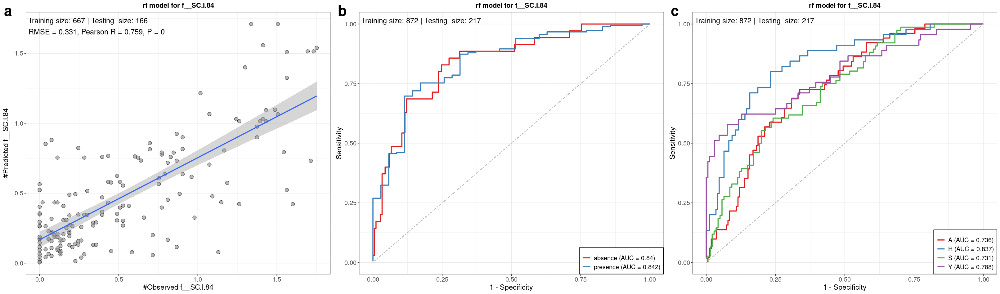

In [10]:
options(repr.plot.width = 13.43 * 2, repr.plot.height = 7.9)
m1 <- rf.rst.reg %>% evaluate_ml_model()
m2 <- rf.rst.cla.bin %>% evaluate_ml_model()
m3 <- rf.rst.cla.mutiple %>% evaluate_ml_model()
cowplot::plot_grid(m1, m2, m3, align = 'hv', ncol = 3, labels = c("a", "b", 'c'), label_size = 28) %>% suppressWarnings()

## Predict values on a geographic map

In [11]:
# Predict f__SC.I.84 based on regression random forest model using historically bioclimatic variables
rf.rst.reg.pred.his <- rf.rst.reg %>%predict_ml_geomap(spat.raster = dataset.dts.aliyun$spa$rast$his[[paste0("Bio", seq(19))]])

In [12]:
# Predict f__SC.I.84 based on regression random forest model using future bioclimatic variables [`BCC-CSM2-MR|ssp585|2061-2080`]
rf.rst.reg.pred.fut <- rf.rst.reg %>% predict_ml_geomap(spat.raster = dataset.dts.aliyun$spa$rast$fut$`BCC-CSM2-MR|ssp585|2061-2080`)

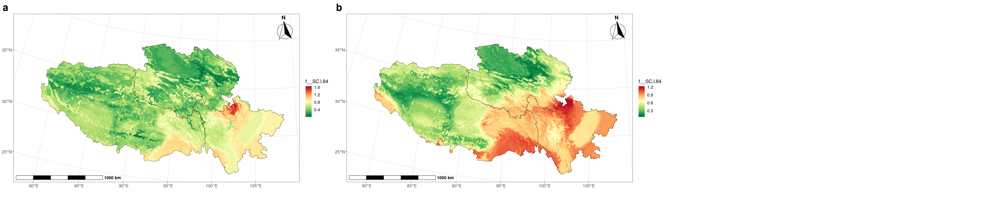

In [13]:
# Show figure 
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9)
h1 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.reg.pred.his) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h2 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.reg.pred.fut) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(h1, h2, align = 'hv', ncol = 3, labels = c("a", "b"), label_size = 28) %>% suppressWarnings()

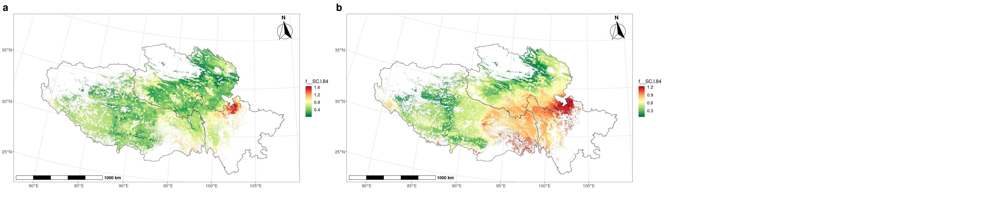

In [14]:
# Mask the predicted results by grassland 
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9)
rf.rst.reg.pred.his.m <- mask_spatraster_by_cla(tar.spat = rf.rst.reg.pred.his, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.reg.pred.fut.m <- mask_spatraster_by_cla(tar.spat = rf.rst.reg.pred.fut, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
h3 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.reg.pred.his.m) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h4 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.reg.pred.fut.m) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(h3, h4, align = 'hv', ncol = 3, labels = c("a", "b"), label_size = 28) %>% suppressWarnings()

In [15]:
# Predict f__SC.I.84 based on binary classification random forest model using historically bioclimatic variables
rf.rst.cla.bin.pred.his <- rf.rst.cla.bin %>% predict_ml_geomap(spat.raster = dataset.dts.aliyun$spa$rast$his[[paste0("Bio", seq(19))]])

In [16]:
# Predict f__SC.I.84 based on binary classification random forest model using future bioclimatic variables [`BCC-CSM2-MR|ssp585|2061-2080`]
rf.rst.cla.bin.pred.fut <- rf.rst.cla.bin %>% predict_ml_geomap(spat.raster = dataset.dts.aliyun$spa$rast$fut$`BCC-CSM2-MR|ssp585|2061-2080`)

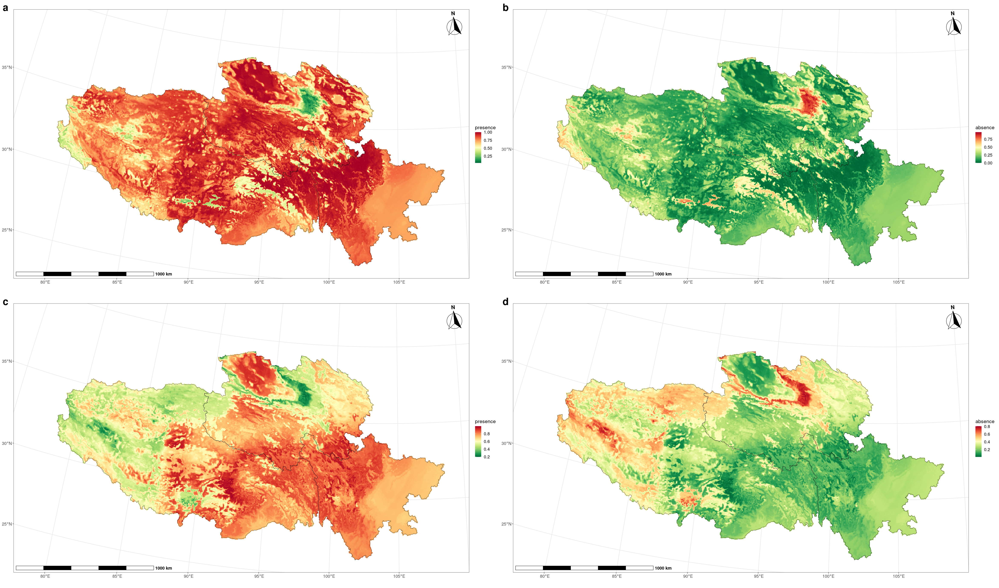

In [17]:
# Show figure 
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9 * 2.9)
h5 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.his$presence) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h6 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.his$absence) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h7 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.fut$presence) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h8 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.fut$absence) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(h5, h6, h7, h8, align = 'hv', ncol = 2, labels = c("a", "b", "c", "d"), label_size = 28) %>% suppressWarnings()

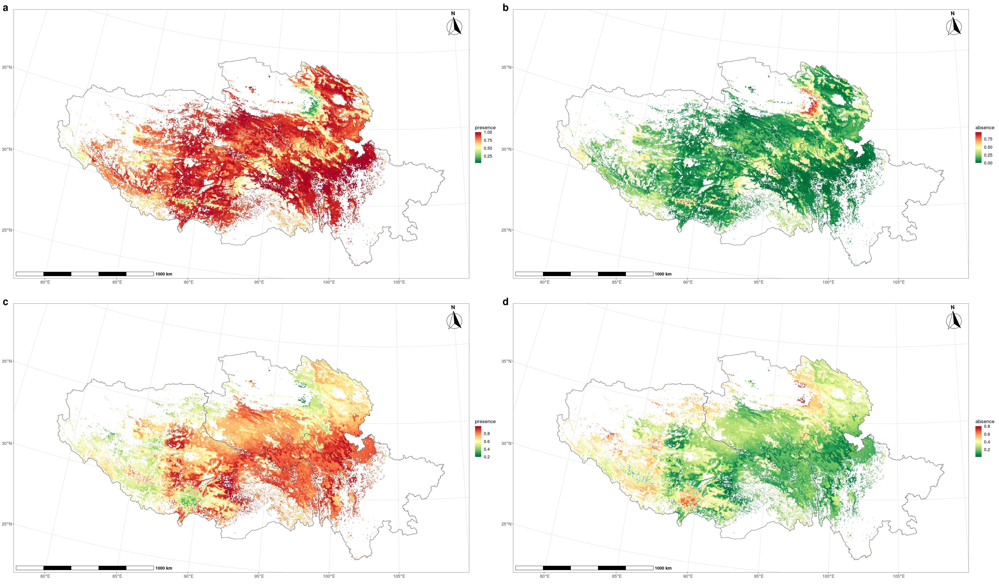

In [18]:
# Mask the predicted results by grassland 
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9 * 2.9)
rf.rst.cla.bin.pred.his.m.p <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.bin.pred.his$presence, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.bin.pred.his.m.a <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.bin.pred.his$absence, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.bin.pred.fut.m.p <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.bin.pred.fut$presence, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.bin.pred.fut.m.a <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.bin.pred.fut$absence, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
h9 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.his.m.p) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h10 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.his.m.a) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h11 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.fut.m.p) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
h12 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.bin.pred.fut.m.a) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(h9, h10, h11, h12, align = 'hv', ncol = 2, labels = c("a", "b", "c", "d"), label_size = 28) %>% suppressWarnings()

In [19]:
# Predict f__SC.I.84 based on mutiple class classification random forest model using historically bioclimatic variables
rf.rst.cla.mutiple.pred.his <- rf.rst.cla.mutiple %>% predict_ml_geomap(spat.raster = dataset.dts.aliyun$spa$rast$his[[paste0("Bio", seq(19))]])

In [20]:
# Predict f__SC.I.84 based on mutiple class classification random forest model using future bioclimatic variables [`BCC-CSM2-MR|ssp585|2061-2080`]
rf.rst.cla.mutiple.pred.fut <- rf.rst.cla.mutiple %>% predict_ml_geomap(spat.raster = dataset.dts.aliyun$spa$rast$fut$`BCC-CSM2-MR|ssp585|2061-2080`)

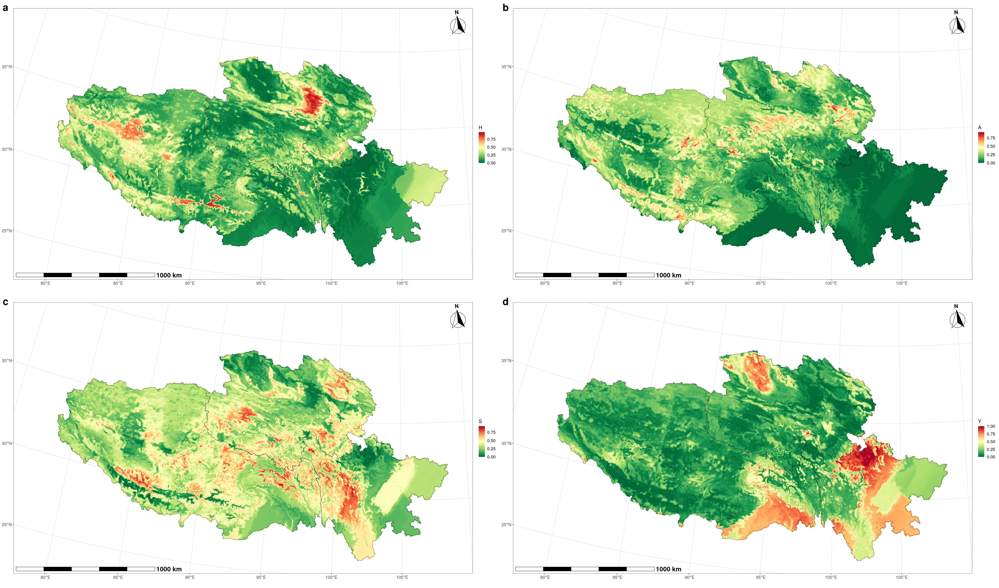

In [21]:
# Show historical prediction
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9 * 2.9)
y1 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his$H) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
y2 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his$A) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
y3 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his$S) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
y4 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his$Y) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
cowplot::plot_grid(y1, y2, y3, y4, align = 'hv', ncol = 2, labels = c("a", "b", "c", "d"), label_size = 28) %>% suppressWarnings()

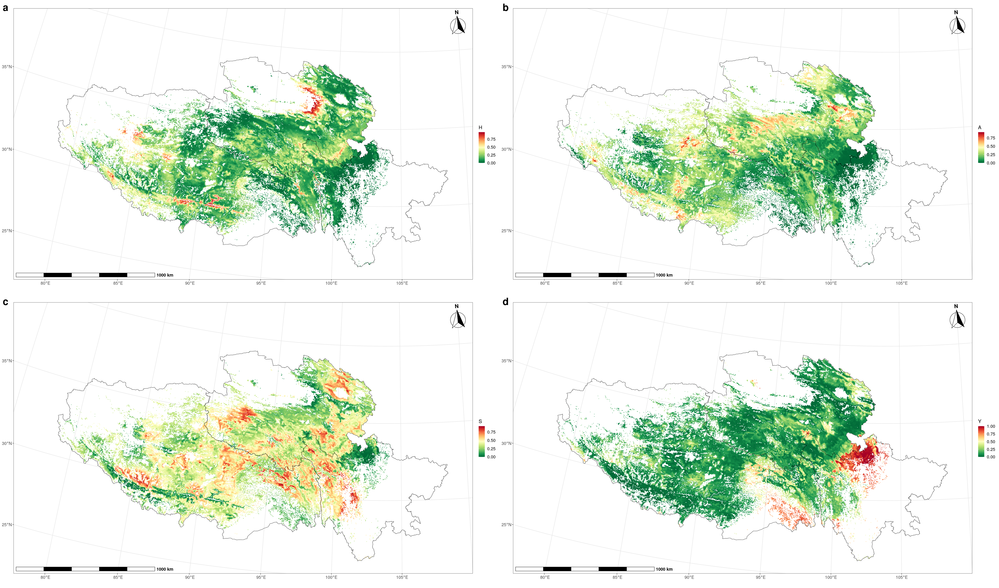

In [22]:
# Mask the historically predicted results by grassland 
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9 * 2.9)
rf.rst.cla.mutiple.pred.his.m.h <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.his$H, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.mutiple.pred.his.m.a <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.his$A, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.mutiple.pred.his.m.s <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.his$S, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.mutiple.pred.his.m.y <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.his$Y, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
y5 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his.m.h) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
y6 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his.m.a) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
y7 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his.m.s) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
y8 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.his.m.y) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(y5, y6, y7, y8, align = 'hv', ncol = 2, labels = c("a", "b", "c", "d"), label_size = 28) %>% suppressWarnings()

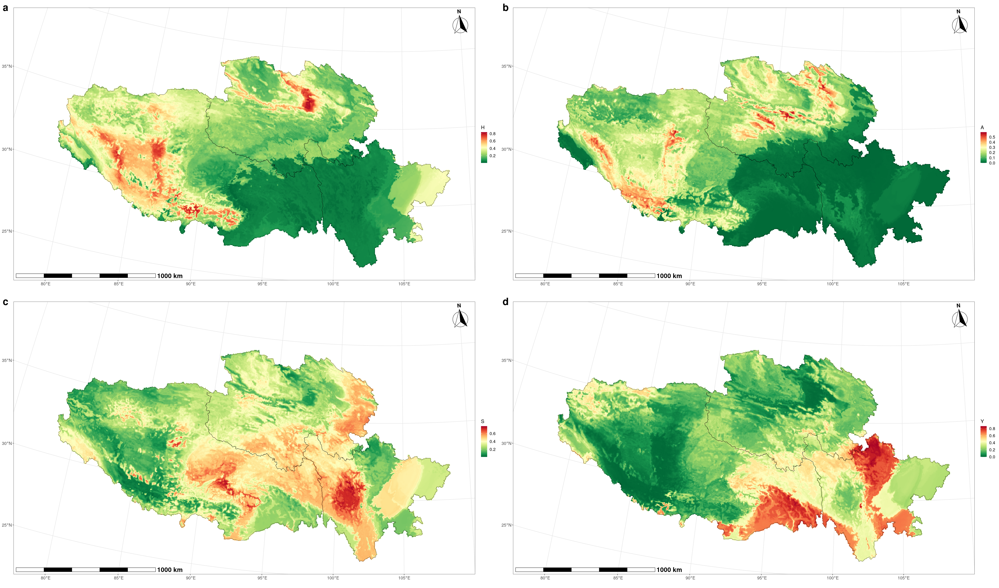

In [23]:
# Show future prediction
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9 * 2.9)
y11 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut$H) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
y22 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut$A) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
y33 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut$S) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
y44 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut$Y) %>% add_scale_bar(size = 1.5) %>% add_north_arrow() %>%add_crs()
cowplot::plot_grid(y11, y22, y33, y44, align = 'hv', ncol = 2, labels = c("a", "b", "c", "d"), label_size = 28) %>% suppressWarnings()

In [ ]:
# Mask the future predicted results by grassland 
options(repr.plot.width = 13.43 * 2.9, repr.plot.height = 7.9 * 2.9)
rf.rst.cla.mutiple.pred.fut.m.h <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.fut$H, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.mutiple.pred.fut.m.a <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.fut$A, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.mutiple.pred.fut.m.s <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.fut$S, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
rf.rst.cla.mutiple.pred.fut.m.y <- mask_spatraster_by_cla(tar.spat = rf.rst.cla.mutiple.pred.fut$Y, ref.spat = dataset.dts.aliyun$spa$rast$cla$LC_Type1, use.class = 10)
y55 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut.m.h) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
y66 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut.m.a) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
y77 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut.m.s) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
y88 <- plot_bmap(map = dataset.dts.aliyun$map) %>% add_spatraster(spat.raster = rf.rst.cla.mutiple.pred.fut.m.y) %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(y55, y66, y77, y88, align = 'hv', ncol = 2, labels = c("a", "b", "c", "d"), label_size = 28) %>% suppressWarnings()